# Setup


In [1]:
! [ -e /content ] && pip install -Uqq fastbook
import fastbook
fastbook.setup_book()
from fastbook import *
from IPython.display import display,HTML

In [2]:
creds = '{"username":"dominikwegiel","key":"b0cf3db20c0e3c30bea377f4d9522932"}'
cred_path = Path('~/.kaggle/kaggle.json').expanduser()
if not cred_path.exists():
    cred_path.parent.mkdir(exist_ok=True)
    cred_path.write_text(creds)
    cred_path.chmod(0o600)

# Dataset


Dataset is made of 50 different landmark object classes collected from web browser using function provided by fastai which allows to get images from DuckDuckGo

In [95]:
classes =['Angkor, Siem Reap, Cambodia', 'The Grand Palace, Bangkok', 'The Eiffel Tower, Paris, France', 'Taj Mahal, Agra, India', 'Petra, Jordan',
          'Mont Saint-Michel, Normandy, France', "Saint Basil's Cathedral, Moscow", 'The Acropolis, Athens, Greece', 'Golden Gate Bridge, San Francisco',
          'La Sagrada Familia, Barcelona, Spain']

In [ ]:
additional_classes = ['Stonehenge, United Kingdom', 'Leaning Tower of Pisa, Italy', 'Statue of Liberty, United States of America', 'Borobudur, Indonesia',
                     'Christ The Redeemer, Brazil', 'Chichen Itza, Mexico', 'Colosseum, Rome, Italy', 'Millau Viaduct, France', 'The Sydney Opera House, Australia',
                     'Saint Peters Basilica, Vatican City', 'Moai, Chile', 'Harmandir Sahib, Amritsar, India', 'Shwedagon Pagoda, Myanmar', 'Hagia Sophia, Turkey',
                     'Hallgrímskirkja, Reykjavík, Iceland', 'Vienna Opera House, Vienna, Austria', 'La Pedrera, Barcelona, Spain', 'Pena National Palace, Sintra, Portugal',
                     'The Duomo, Florence, Italy', 'Palace of Versailles, Paris, France', 'Marina Bay Sands, Singapore', 'Hawa Mahal, Jaipur, India',
                      'The Chrysler Building, New York, United States', 'Las Lajas Sanctuary, Nariño, Colombia', 'Dancing House, Prague, Czech Republic', 
                     'Semperoper, Dresden, Germany', 'Potala Palace, Lhasa, Tibet', 'Pyramids of Giza, Egypt', 'Itsukushima Shinto Shrine, Japan',
                      'Itsukushima Shinto Shrine, Japan', 'Rila Monastery, Bulgaria', 'Arg-e Bam, Iran', 'La Grand-Place, Brussels, Belgium', 'Meteora, Greece',
                     'Mir-i-Arab Madrasa, Bukhara, Uzbekistan', 'Notre Dame Cathedral, Paris, France', 'Prambanan, Indonesia', 'Neuschwanstein Castle, Schwangau, Germany',
                     'Machu Picchu, Peru', 'The Great Wall of China, China']

In [113]:
ds_train_path = Path('./Dataset/train')
ds_test_path = Path('./Dataset/test')
if not ds_train_path.exists():
    ds_train_path.mkdir(parents=True)
    if not ds_test_path.exists():
        ds_test_path.mkdir(parents=True)
    for c in classes:
        dest_train = (ds_train_path/c)
        dest_test = (ds_test_path/c)
        dest_train.mkdir(exist_ok=True)
        dest_test.mkdir(exist_ok=True)
        urls = search_images_ddg(c, max_images=200)
        download_images(dest_train, urls=urls[:180])
        download_images(dest_test, urls=urls[180:])

In [110]:
fns = get_image_files(ds_train_path)
fns

(#684) [Path('Dataset/small/train/The Eiffel Tower, Paris, France/6f773afd-8c38-4d8b-a6b1-a7b1167e04c3.jpg'),Path('Dataset/small/train/The Eiffel Tower, Paris, France/40bd388f-0d39-41ff-af1b-8610f169bb90.jpg'),Path('Dataset/small/train/The Eiffel Tower, Paris, France/783ca861-0e95-4af2-91af-0ec82d032de4.jpg'),Path('Dataset/small/train/The Eiffel Tower, Paris, France/17000d84-f79c-43f0-b506-1065faf532e3.jpg'),Path('Dataset/small/train/The Eiffel Tower, Paris, France/ae0f854b-e44d-45cf-9345-b1d85c39de37.jpg'),Path('Dataset/small/train/The Eiffel Tower, Paris, France/5469ffa5-c097-40c0-a95b-714b683a56c4.jpg'),Path('Dataset/small/train/The Eiffel Tower, Paris, France/b3828da6-dd2d-427e-aa5b-cbf2cc68b048.jpg'),Path('Dataset/small/train/The Eiffel Tower, Paris, France/1c7f8711-c0ed-4d43-905f-2a7acb9e62c2.jpg'),Path('Dataset/small/train/The Eiffel Tower, Paris, France/bb6343bd-8bcb-4784-b1fb-c7134e4a5dd8.jpg'),Path('Dataset/small/train/The Eiffel Tower, Paris, France/a2666ea0-33d1-4141-a40b-3

In [108]:
failed = verify_images(fns) # Finding corrupted files
failed

(#1044) [Path('Dataset/small/train/La Sagrada Familia, Barcelona, Spain/3c2b53fd-7c70-4ed8-87d1-55586ff7ee50.jpg'),Path('Dataset/small/train/La Sagrada Familia, Barcelona, Spain/d8130cdd-72d8-450d-81be-740422f9a43e.jpg'),Path('Dataset/small/train/La Sagrada Familia, Barcelona, Spain/fcaf27dc-1f5e-45c0-9e0c-684a21d95a91.jpg'),Path('Dataset/small/train/La Sagrada Familia, Barcelona, Spain/28a8b2de-bb71-4ec6-930f-c2093fcd5684.jpg'),Path('Dataset/small/train/La Sagrada Familia, Barcelona, Spain/72af8b77-b792-4609-872d-83328afc45bb.jpg'),Path('Dataset/small/train/La Sagrada Familia, Barcelona, Spain/adb74bac-7f43-4c3b-9eca-14c498a41c30.jpg'),Path('Dataset/small/train/La Sagrada Familia, Barcelona, Spain/32ea9709-d85e-474c-90bf-2b79bf2b215c.jpg'),Path('Dataset/small/train/La Sagrada Familia, Barcelona, Spain/b53175df-0697-4f48-bcd5-a8532a92c909.jpg'),Path('Dataset/small/train/La Sagrada Familia, Barcelona, Spain/9fff5e01-cd80-48e0-ad8e-37ee2e4cf7ac.jpg'),Path('Dataset/small/train/La Sagrada 

In [109]:
# For now there aren't any corrupted files
# Corrupted files will be deleted by the code below
failed.map(Path.unlink) 

(#1044) [None,None,None,None,None,None,None,None,None,None...]

In [7]:
def m_images_per_class(classes, ds_path, show=False):
    """Function made to print class names and quantity of objects per class""""
  most = 0
  m_class = ''
  for c in classes:
    images = len(get_image_files(ds_path/c))
    if images > most: 
      most = images
      m_class = c
    if show:
      print(f'{c}: {images}')
  return m_class

In [102]:
m_images_per_class(classes, ds_train_path, show=True)

Angkor, Siem Reap, Cambodia: 174
The Grand Palace, Bangkok: 173
The Eiffel Tower, Paris, France: 168
Taj Mahal, Agra, India: 175
Petra, Jordan: 0
Mont Saint-Michel, Normandy, France: 0
Saint Basil's Cathedral, Moscow: 0
The Acropolis, Athens, Greece: 0
Golden Gate Bridge, San Francisco: 0
La Sagrada Familia, Barcelona, Spain: 0


'Taj Mahal, Agra, India'

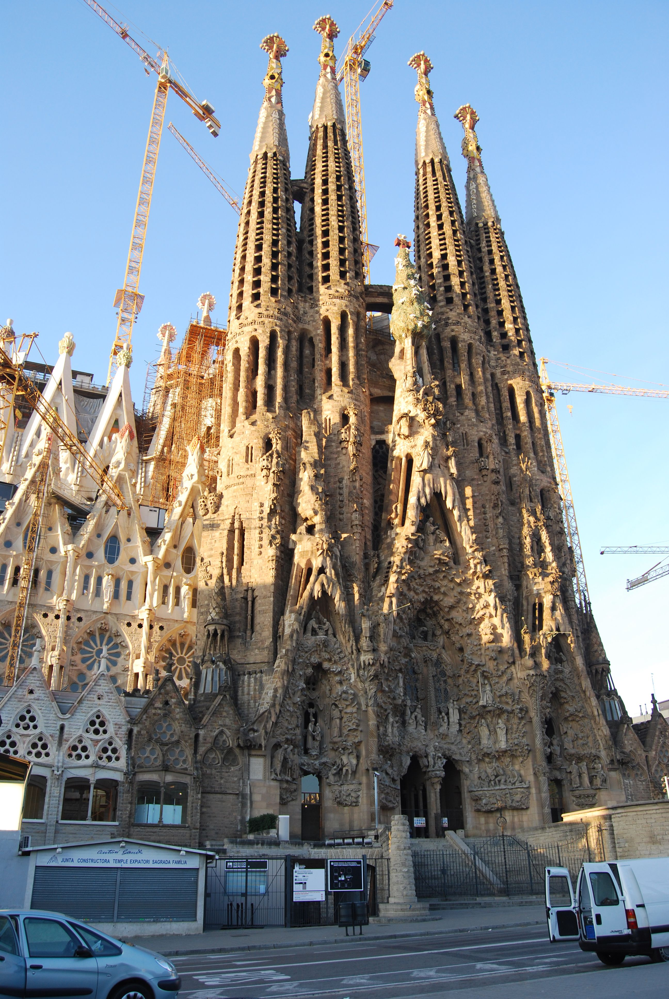

In [10]:
fns = get_image_files(ds_path)
im = Image.open(fns[0])
im

In [117]:
landmarks = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,
    splitter=RandomSplitter(valid_pct=0.2, seed=42),
    get_y=parent_label,
    item_tfms=Resize(224)
)

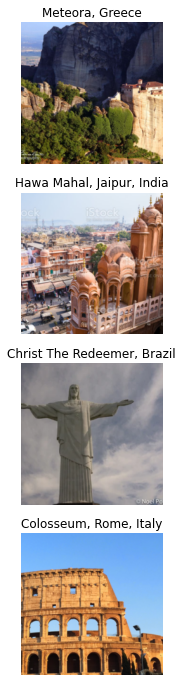

In [118]:
dls = landmarks.dataloaders(ds_train_path)
dls.show_batch(nrows=4, max_n=4)

## Using fastai to clean data

In [119]:
learn = vision_learner(dls, resnet18, metrics=[accuracy, error_rate])
learn.fine_tune(4)

/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,2.011669,0.513334,0.863263,0.136737,01:46


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.523314,0.252132,0.934859,0.065141,01:47
1,0.290162,0.184660,0.949531,0.050469,01:47
2,0.138686,0.146522,0.957747,0.042254,01:49
3,0.078870,0.140884,0.962441,0.037559,01:50


In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

In [120]:
interp.plot_top_losses(5, nrows=5)

NameError: name 'interp' is not defined

In [16]:
from fastai.vision.widgets import *

cleaner = ImageClassifierCleaner(learn)
cleaner

/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))


In [17]:
for idx in cleaner.delete(): cleaner.fns[idx].unlink()

In [18]:
m_images_per_class(c_landmarks, show=True)

Angkor, Siem Reap, Cambodia: 287
The Grand Palace, Bangkok: 295
The Eiffel Tower, Paris, France: 291
Taj Mahal, Agra, India: 289
Petra, Jordan: 287
Machu Picchu, Peru: 284
The Great Wall of China, China: 287
Mont Saint-Michel, Normandy, France: 287
Saint Basil's Cathedral, Moscow: 292
The Acropolis, Athens, Greece: 280
Golden Gate Bridge, San Francisco: 282
Neuschwanstein Castle, Schwangau, Germany: 284
La Sagrada Familia, Barcelona, Spain: 282


'The Grand Palace, Bangkok'

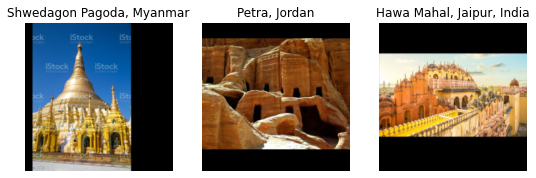

In [36]:
landmarks = landmarks.new(item_tfms=Resize(224, ResizeMethod.Pad, pad_mode='zeros')) #Resize by padding
dls = landmarks.dataloaders(ds_train_path)
dls.train.show_batch(max_n=3, nrows=1)

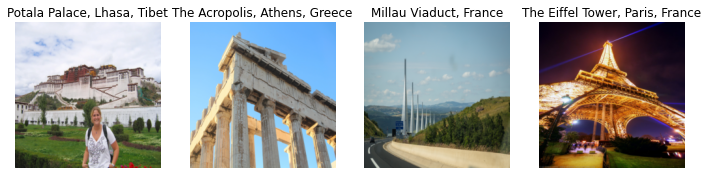

In [51]:
landmarks = landmarks.new(item_tfms=Resize(224, ResizeMethod.Squish)) #Resize by Squishing the images
dls = landmarks.dataloaders(ds_train_path)
dls.train.show_batch(max_n=4, nrows=1)

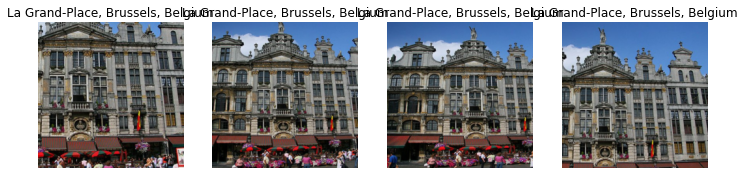

In [64]:
landmarks = landmarks.new(item_tfms=RandomResizedCrop(224)) #Resize by random cropping the images
dls = landmarks.dataloaders(ds_train_path)
dls.train.show_batch(max_n=4, nrows=1, unique=True)

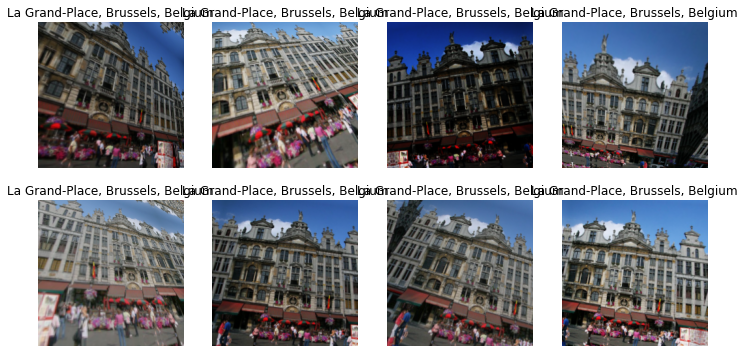

In [77]:
landmarks = landmarks.new(item_tfms=Resize(224), batch_tfms=aug_transforms(mult=2)) #Image Augmentation
dls = landmarks.dataloaders(ds_train_path)
dls.train.show_batch(max_n=8, nrows=2, unique=True)

In [4]:
def get_dls(bs, size, path):
    dblock = DataBlock(
        blocks=(ImageBlock, CategoryBlock),
        get_items=get_image_files,
        splitter=RandomSplitter(valid_pct=0.2, seed=42),
        get_y=parent_label,
        item_tfms=Resize(460),
        batch_tfms=[*aug_transforms(size=size, min_scale=0.75),
                    Normalize()]
    )
    return dblock.dataloaders(path, bs=bs)

In [7]:
dls = get_dls(64, 224, ds_path)

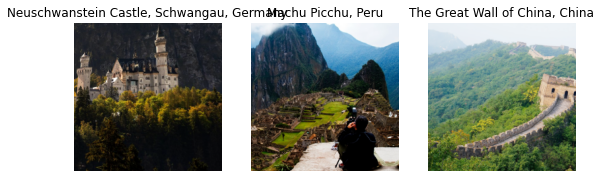

In [23]:
dls.show_batch(max_n=3)

In [ ]:
dls.test_dl()

# Baseline model

Simple model made to check if the predictions other model are making are of any use, works as a threshold for prediction accuracy

In [19]:
def conv(ni, nf, ks=3, act=True):
    res = nn.Conv2d(ni, nf, stride=2, kernel_size=ks, padding=ks//2)
    if act: res = nn.Sequential(res, nn.ReLU())
    return res

In [26]:
# Activation map size after each convolution is written next to each layer
simple_cnn = sequential(
    conv(3 ,4),            #112x112
    conv(4 ,8),            #56x56
    conv(8 ,16),           #28x28
    conv(16,32),           #14x14
    conv(32, 64),          #7x7
    conv(64, 128),         #4x4
    conv(128, 256),        #2x2
    conv(256,13, act=False), #1x1
    Flatten(),
)
learn = Learner(dls, simple_cnn, loss_func=F.cross_entropy, metrics=accuracy)

/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))


SuggestedLRs(valley=0.004365158267319202)

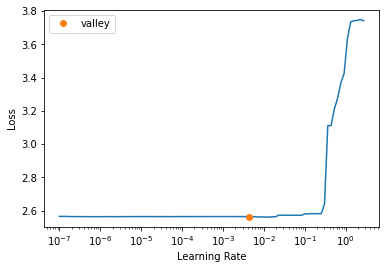

In [27]:
learn.lr_find() # Using learning rate finder to find optimal learning_rate parameter

In [28]:
learn.fit_one_cycle(40, 2e-2)

epoch,train_loss,valid_loss,accuracy,time
0,2.541259,2.471072,0.138255,01:16
1,2.409856,2.221200,0.264430,01:17
2,2.300233,2.228410,0.238926,01:14
3,2.207744,2.133707,0.273825,01:15
4,2.118078,2.094841,0.314094,01:17
5,2.093431,2.027662,0.326174,01:14
6,2.067117,2.011310,0.311409,01:14
7,1.994530,1.836928,0.421477,01:11
8,1.952516,1.808226,0.413423,01:14
9,1.887867,2.117450,0.324832,01:11


/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(st

## Improving Model Performance

### Weight Decay

In [22]:
simple_cnn = sequential(
    conv(3 ,4),            #112x112
    conv(4 ,8),            #56x56
    conv(8 ,16),           #28x28
    conv(16,32),           #14x14
    conv(32, 64),          #7x7
    conv(64, 128),         #4x4
    conv(128, 256),        #2x2
    conv(256,13, act=False), #1x1
    Flatten(),
)
learn = Learner(dls, simple_cnn, loss_func=F.cross_entropy, metrics=[accuracy, error_rate])

In [24]:
learn.fit_one_cycle(40, 2e-2, wd=0.1)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.957570,1.318082,0.594631,0.405369,00:52
1,0.903628,1.312277,0.587919,0.412081,00:54
2,0.866508,1.339564,0.594631,0.405369,00:53
3,0.867445,1.327157,0.574497,0.425503,00:56
4,0.904455,1.389490,0.571812,0.428188,00:55
5,0.958276,1.334974,0.593289,0.406711,00:54
6,1.020630,1.414359,0.566443,0.433557,00:55
7,1.082981,1.381347,0.555705,0.444295,00:53
8,1.169853,1.666953,0.512752,0.487248,00:55
9,1.170037,1.385339,0.601342,0.398658,00:55


/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(st

### Architecture Change

Changing kernel size of first layer and it's output to 8 in order to see if the model can pick up more features from bigger ammount of output values to compute from that layer, and how this affects training

In [29]:
simple_cnn = sequential(
    conv(3 ,8, ks=5),      #112x112         
    conv(8 ,16),           #28x28
    conv(16,32),           #14x14
    conv(32, 64),          #7x7
    conv(64, 128),         #4x4
    conv(128, 256),        #2x2
    conv(256,13, act=False), #1x1
    Flatten(),
)
learn = Learner(dls, simple_cnn, loss_func=F.cross_entropy, metrics=accuracy)

In [30]:
learn.fit_one_cycle(40, 2e-2)

epoch,train_loss,valid_loss,accuracy,time
0,2.781775,2.611209,0.075168,01:40
1,2.618907,2.540376,0.097987,01:37
2,2.517254,2.414686,0.166443,01:37
3,2.424388,2.262415,0.224161,01:33
4,2.368607,2.244470,0.222819,01:35
5,2.306863,2.170534,0.275168,01:37
6,2.255772,2.135378,0.271141,01:37
7,2.298580,2.375488,0.216107,01:35
8,2.325088,2.182658,0.264430,01:36
9,2.295774,2.188281,0.264430,01:31


/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(st

### Adding BatchNormalization Layers

In [31]:
def conv(ni, nf, ks=3, act=True):
    layers = [nn.Conv2d(ni, nf, stride=2, kernel_size=ks, padding=ks//2)]
    if act: layers.append(nn.ReLU())
    layers.append(nn.BatchNorm2d(nf))
    return nn.Sequential(*layers)

In [32]:
simple_cnn = sequential(
    conv(3 ,4),            #112x112
    conv(4 ,8),            #56x56
    conv(8 ,16),           #28x28
    conv(16,32),           #14x14
    conv(32, 64),          #7x7
    conv(64, 128),         #4x4
    conv(128, 256),        #2x2
    conv(256,13, act=False), #1x1
    Flatten(),
)
learn = Learner(dls, simple_cnn, loss_func=F.cross_entropy, metrics=accuracy)

In [33]:
learn.fit_one_cycle(40, 2e-2)

epoch,train_loss,valid_loss,accuracy,time
0,2.168035,1.847400,0.401342,01:31
1,1.889543,1.558122,0.491275,01:37
2,1.704213,1.360139,0.574497,01:38
3,1.558893,1.393739,0.563758,01:42
4,1.416939,1.368520,0.577181,01:40
5,1.284913,1.065727,0.655034,01:36
6,1.226774,1.136045,0.641611,01:15
7,1.118006,0.951591,0.699329,01:11
8,1.061017,1.007671,0.689933,01:10
9,0.995179,0.893573,0.720805,01:12


/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(st

### Using Dropout

In [34]:
def conv(ni, nf, ks=3, act=True):
    layers = [nn.Conv2d(ni, nf, stride=2, kernel_size=ks, padding=ks//2)]
    if act: 
        layers.append(nn.ReLU())
        layers.append(nn.Dropout(0.25))
    layers.append(nn.BatchNorm2d(nf))
    return nn.Sequential(*layers)

In [35]:
simple_cnn = sequential(
    conv(3 ,4),            #112x112
    conv(4 ,8),            #56x56
    conv(8 ,16),           #28x28
    conv(16,32),           #14x14
    conv(32, 64),          #7x7
    conv(64, 128),         #4x4
    conv(128, 256),        #2x2
    conv(256,13, act=False), #1x1
    Flatten(),
)
learn = Learner(dls, simple_cnn, loss_func=F.cross_entropy, metrics=accuracy)

In [36]:
learn.fit_one_cycle(40, 2e-2)

epoch,train_loss,valid_loss,accuracy,time
0,2.662956,3.697905,0.124832,01:25
1,2.398525,3.307124,0.157047,01:24
2,2.129157,2.304190,0.291275,01:19
3,1.943150,2.863145,0.242953,01:25
4,1.812294,2.111979,0.355705,01:22
5,1.674871,2.055832,0.375839,01:23
6,1.572501,1.618891,0.476510,01:23
7,1.478976,1.777954,0.418792,01:23
8,1.394287,1.252285,0.606711,01:25
9,1.367672,1.585611,0.520805,01:20


/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(st

# Fully convolutional network

Using standard CNN architecture with AvgPool layer

In [37]:
def conv(ni, nf): return ConvLayer(ni, nf, stride=2)
cnn_net = nn.Sequential(
        conv(3, 4),
        conv(4 ,8),          
        conv(8 ,16),
        conv(16, 32),
        conv(32, 64),
        conv(64, 128),
        conv(128, 256),
        nn.AdaptiveAvgPool2d(1),
        Flatten(),
        nn.Linear(256, dls.c))
learn = Learner(dls, cnn_net, loss_func=F.cross_entropy, metrics=accuracy)

In [38]:
learn.fit_one_cycle(40, 2e-2)

epoch,train_loss,valid_loss,accuracy,time
0,2.236840,1.984126,0.334228,01:29
1,1.935429,1.597903,0.496644,01:25
2,1.680065,1.423579,0.539597,01:21
3,1.512765,1.838358,0.480537,01:23
4,1.404876,1.330213,0.589262,01:19
5,1.281024,3.047138,0.378523,01:24
6,1.195675,1.411751,0.613423,01:20
7,1.114948,1.236135,0.620134,01:18
8,1.003935,0.906831,0.695302,01:23
9,0.947923,1.208737,0.625503,01:22


/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(st

# ResNet Model

Creating ResNet model from scratch

In [26]:
def _conv_block(ni,nf,stride):
    return nn.Sequential(
        ConvLayer(ni, nf, stride=stride),
        ConvLayer(nf, nf, act_cls=None, norm_type=NormType.BatchZero))

In [27]:
class ResBlock(Module):
    """ResNet block handling changing shape in skip connections"""
    def __init__(self, ni, nf, stride=1):
        self.convs = _conv_block(ni,nf,stride)
        self.idconv = noop if ni==nf else ConvLayer(ni, nf, 1, act_cls=None) # Assuring that input connection and output connection sizes are the same so that they can be added
        self.pool = noop if stride==1 else nn.AvgPool2d(2, ceil_mode=True) # Making sure that stride isn't bigger than 1 and it doesn't cout outputs size in half

    def forward(self, x):
        return F.relu(self.convs(x) + self.idconv(self.pool(x)))

In [28]:
def get_model():
    return nn.Sequential(
        block(3, 16),
        block(16, 32),
        block(32, 64),
        block(64, 128),
        block(128, 256),
        nn.AdaptiveAvgPool2d(1),
        Flatten(),
        nn.Linear(256, dls.c))

In [29]:
def get_learner(m):
    return Learner(dls, m, loss_func=nn.CrossEntropyLoss(), metrics=accuracy
                  ).to_fp16()

In [30]:
def block(ni,nf): return ResBlock(ni, nf, stride=2)
learn = get_learner(get_model())

In [46]:
learn.fit_one_cycle(5, 3e-3)

epoch,train_loss,valid_loss,accuracy,time
0,2.254933,2.018434,0.331544,01:10
1,2.020681,1.859456,0.425503,01:01
2,1.810911,1.617992,0.496644,01:02
3,1.616355,1.344096,0.579866,01:04
4,1.462239,1.309708,0.606711,01:04


/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))


In [31]:
def block(ni, nf):
    return nn.Sequential(ResBlock(ni, nf, stride=2), ResBlock(nf, nf)) # Training twice as deep architectures by using 2 ResBlock's

In [48]:
learn = get_learner(get_model())
learn.fit_one_cycle(5, 3e-3)

epoch,train_loss,valid_loss,accuracy,time
0,2.285418,2.180445,0.259060,01:11
1,1.955143,1.752037,0.434899,01:06
2,1.695958,1.397039,0.538255,01:08
3,1.451785,1.152925,0.629530,01:06
4,1.271344,1.059860,0.672483,01:08


/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))


In [32]:
def _resnet_stem(*sizes):
    """Implementing first layer of the network called the stem """
    return [
        ConvLayer(sizes[i], sizes[i+1], 3, stride = 2 if i==0 else 1)
            for i in range(len(sizes)-1)
    ] + [nn.MaxPool2d(kernel_size=3, stride=2, padding=1)]

In [33]:
class ResNet(nn.Sequential):
    """Implementation of modern ResNet""""
    def __init__(self, n_out, layers, expansion=1):
        stem = _resnet_stem(3,32,32,64)
        self.block_szs = [64, 64, 128, 256, 512]
        for i in range(1,5): self.block_szs[i] *= expansion
        blocks = [self._make_layer(*o) for o in enumerate(layers)]
        super().__init__(*stem, *blocks,
                         nn.AdaptiveAvgPool2d(1), Flatten(),
                         nn.Linear(self.block_szs[-1], n_out))
    
    def _make_layer(self, idx, n_layers):
        """Creates a series of n_layers blocks"""
        stride = 1 if idx==0 else 2
        ch_in,ch_out = self.block_szs[idx:idx+2]
        return nn.Sequential(*[
            ResBlock(ch_in if i==0 else ch_out, ch_out, stride if i==0 else 1)
            for i in range(n_layers)
        ])

In [34]:
rn = ResNet(dls.c, [2,2,2,2]) # ResNet-18

In [35]:
learn = get_learner(rn)
learn.fit_one_cycle(5, 3e-3)

epoch,train_loss,valid_loss,accuracy,time
0,1.977718,1.699662,0.448322,01:08
1,1.610859,1.281672,0.570470,01:10
2,1.283619,0.901840,0.726174,01:09
3,0.980173,0.597966,0.810738,01:09
4,0.753731,0.537380,0.837584,01:10


/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))


In [36]:
def _conv_block(ni,nf,stride): # Using bottleneck layer design which allows to use more filters in the same ammount of time
    return nn.Sequential(
        ConvLayer(ni, nf//4, 1),
        ConvLayer(nf//4, nf//4, stride=stride), 
        ConvLayer(nf//4, nf, 1, act_cls=None, norm_type=NormType.BatchZero))

In [37]:
rn = ResNet(dls.c, [3,4,6,3], 4)

In [38]:
learn = get_learner(rn)
learn.fit_one_cycle(20, 3e-3)

epoch,train_loss,valid_loss,accuracy,time
0,1.828758,1.569441,0.519463,01:31
1,1.537804,2.136514,0.389262,01:33
2,1.369270,1.983774,0.426846,01:33
3,1.217864,2.826703,0.347651,01:32
4,1.081810,1.995250,0.508725,01:34
5,0.896326,1.219677,0.641611,01:31
6,0.741784,1.570720,0.569128,01:34
7,0.659203,0.806606,0.747651,01:30
8,0.543780,0.820916,0.762416,01:31
9,0.485521,0.744792,0.777181,01:30


/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(st

# Transfer Learning

Using pretrainer NN's

## Fine Tuning

/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))


SuggestedLRs(valley=0.0008317637839354575)

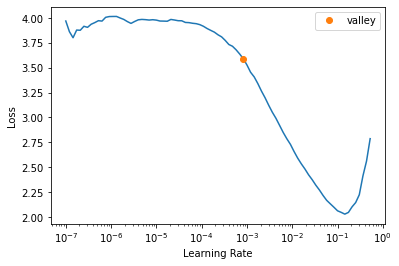

In [28]:
learn = vision_learner(dls, resnet18, metrics=[accuracy, error_rate])
learn.lr_find()

In [23]:
learn.unfreeze()

In [24]:
learn.fit_one_cycle(6, lr_max=1e-3)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.209154,1.179836,0.769127,0.230872,01:01
1,0.404526,1.247736,0.795973,0.204027,01:01
2,0.334197,0.142491,0.951678,0.048322,01:00
3,0.214441,0.073375,0.971812,0.028188,01:01
4,0.130372,0.052696,0.982550,0.017450,01:01
5,0.081223,0.044375,0.981208,0.018792,01:00


/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))


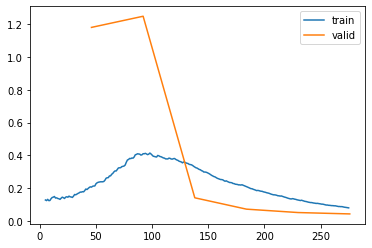

In [25]:
learn.recorder.plot_loss()

## Progressive Resizing

Using the technique proposed in fastai course that allows to keep better 

In [35]:
dls = get_dls(64, 128, ds_path)
learn = vision_learner(dls, resnet18, metrics=[accuracy, error_rate])
learn.fit_one_cycle(3, 3e-3)

/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.512816,0.363734,0.893960,0.106040,00:59
1,0.775934,0.242038,0.923490,0.076510,00:58
2,0.476620,0.208608,0.940940,0.059060,00:58


/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))


In [36]:
dls = get_dls(64, 224, ds_path)
learn.fit_one_cycle(6, lr_max=1e-3)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.305266,0.195330,0.940940,0.059060,00:58
1,0.273479,0.154265,0.950336,0.049664,00:59
2,0.243916,0.146634,0.950336,0.049664,00:57
3,0.215498,0.128980,0.957047,0.042953,00:58
4,0.195106,0.138887,0.954362,0.045638,00:57
5,0.175044,0.139005,0.954362,0.045638,00:58


/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))


## Deeper architectures

In [14]:
learn = vision_learner(dls, resnet34, metrics=[accuracy, error_rate])
learn.fine_tune(10)

/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pth


  0%|          | 0.00/83.3M [00:00<?, ?B/s]

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.427039,0.186211,0.950336,0.049664,01:02


/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.287572,0.081786,0.975839,0.024161,01:11
1,0.170714,0.058690,0.983893,0.016107,01:13
2,0.116468,0.046673,0.986577,0.013423,01:12
3,0.084950,0.041101,0.978523,0.021477,01:11
4,0.057219,0.044456,0.987919,0.012081,01:12
5,0.050069,0.052271,0.987919,0.012081,01:11
6,0.034596,0.042133,0.986577,0.013423,01:10
7,0.029086,0.035071,0.989262,0.010738,01:10
8,0.020911,0.032591,0.989262,0.010738,01:12
9,0.015967,0.030648,0.990604,0.009396,01:12


/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(st

In [8]:
learn = vision_learner(dls, resnet50, metrics=[accuracy, error_rate])
learn.fine_tune(10)

/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth


  0%|          | 0.00/97.8M [00:00<?, ?B/s]

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.903265,0.162580,0.953020,0.046980,01:21


/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.157094,0.069751,0.979866,0.020134,01:34
1,0.122390,0.057626,0.982550,0.017450,01:37
2,0.112827,0.043417,0.982550,0.017450,01:37
3,0.079103,0.048284,0.985235,0.014765,01:34
4,0.052690,0.032453,0.986577,0.013423,01:34
5,0.037165,0.020041,0.994631,0.005369,01:34
6,0.027516,0.020892,0.994631,0.005369,01:34
7,0.019769,0.026206,0.993289,0.006711,01:34
8,0.014542,0.022102,0.995973,0.004027,01:35
9,0.010099,0.019271,0.997315,0.002685,01:35


/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(st

In [13]:
learn = vision_learner(dls, resnet101, metrics=[accuracy, error_rate]).to_fp16()
learn.fine_tune(10)

/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=ResNet101_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet101_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet101-63fe2227.pth" to /root/.cache/torch/hub/checkpoints/resnet101-63fe2227.pth


  0%|          | 0.00/171M [00:00<?, ?B/s]

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.831356,0.129492,0.961074,0.038926,01:40


/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.131100,0.062310,0.978523,0.021477,02:05
1,0.075848,0.038551,0.986577,0.013423,02:06
2,0.074649,0.057517,0.975839,0.024161,02:07
3,0.079244,0.061528,0.974497,0.025503,02:04
4,0.052094,0.032366,0.991946,0.008054,02:03
5,0.033303,0.035385,0.989262,0.010738,02:04
6,0.018679,0.036794,0.989262,0.010738,02:05
7,0.010465,0.036231,0.989262,0.010738,02:04
8,0.005530,0.035846,0.987919,0.012081,02:05
9,0.003384,0.034273,0.989262,0.010738,02:05


/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(st

In [25]:
learn.export(fname='model.pkl')

In [26]:
path = Path()
path.ls(file_exts='.pkl')

(#1) [Path('model.pkl')]

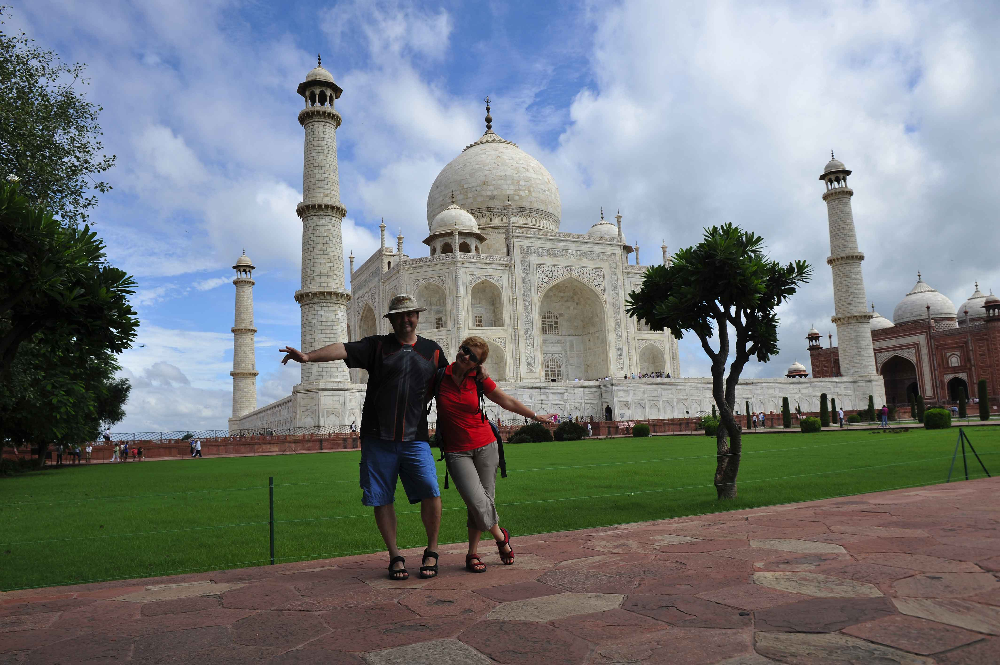

In [33]:
Image.open('taj_mahal.jpg')

In [27]:
learn.predict('taj_mahal.jpg')

('Taj Mahal, Agra, India',
 TensorBase(8),
 TensorBase([1.5922e-09, 2.3418e-11, 2.0665e-11, 2.1005e-09, 1.7139e-11, 6.1034e-10, 9.4845e-11, 9.7569e-10, 1.0000e+00, 2.3299e-10, 3.5996e-10, 3.6410e-10, 6.1389e-11]))

# Understanding the Model

## CAM - Class Actiation Map

In [9]:
img = PILImage.create('angkor.jpg')
x, = first(dls.test_dl([img]))
x.shape

torch.Size([1, 3, 224, 224])

In [15]:
class Hook():
    def hook_func(self, m, i, o): self.stored = o.detach().clone()

In [12]:
class Hook():
    """Hooks allow to inject code into forward or backward calculations of the model,
    they can be attached to any layer of the model and they will be used when computiing the outputs"""
        
    def __init__(self, m):
        self.hook = m.register_forward_hook(self.hook_func)   
        
    def hook_func(self, m, i, o): self.stored = o.detach().clone()
    
    def __enter__(self, *args): return self

    def __exit__(self, *args): self.hook.remove()
     

In [47]:
with Hook(learn.model[0]) as hook:# Attaching hook to the last layer of CNN body of the model
    with torch.no_grad(): output = learn.model.eval()(x.cuda())
    act = hook.stored 

In [48]:
pred = F.softmax(output, dim=-1) # Predictions of the model after feeding it the data
pred, pred.argmax()

(TensorBase([[1.0000e+00, 4.6517e-08, 9.7351e-08, 8.4424e-08, 1.6759e-08, 2.5829e-07, 9.1791e-11, 9.6821e-09, 2.1685e-08, 4.0947e-10, 6.2462e-07, 5.9920e-08, 1.1720e-09]], device='cuda:0'),
 TensorBase(0, device='cuda:0'))

In [24]:
dls.vocab

['Angkor, Siem Reap, Cambodia', 'Golden Gate Bridge, San Francisco', 'La Sagrada Familia, Barcelona, Spain', 'Machu Picchu, Peru', 'Mont Saint-Michel, Normandy, France', 'Neuschwanstein Castle, Schwangau, Germany', 'Petra, Jordan', "Saint Basil's Cathedral, Moscow", 'Taj Mahal, Agra, India', 'The Acropolis, Athens, Greece', 'The Eiffel Tower, Paris, France', 'The Grand Palace, Bangkok', 'The Great Wall of China, China']

In [32]:
learn.model[1][-1].weight.shape, act.shape

(torch.Size([13, 512]), torch.Size([512, 7, 7]))

In [49]:
# Dot product of weight matrix (13 by activations) and activations (batch size by activations by rows by cols)
cam_map = torch.einsum('ck,kij->cij', learn.model[1][-1].weight, act[0]) 
cam_map.shape

torch.Size([13, 7, 7])

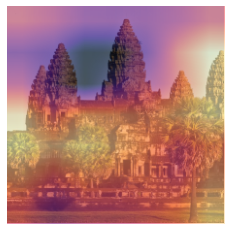

In [50]:
x_dec = TensorImage(dls.train.decode((x,))[0][0])
_,ax = plt.subplots()
x_dec.show(ctx=ax)
ax.imshow(cam_map[1].detach().cpu(), alpha=0.6, extent=(0,224,224,0),
              interpolation='bilinear', cmap='magma');

## Gradient CAM

In [2]:
class HookBackwd():
    def __init__(self, m):
        self.hook = m.register_backward_hook(self.hook_func)   
    def hook_func(self, m, gi, go): self.stored = go[0].detach().clone()
    def __enter__(self, *args): return self
    def __exit__(self, *args): self.hook.remove()

In [70]:
def get_gradcam(learn, x, res_group, cls=0):
    with HookBackwd(learn.model[0][res_group]) as hookg:
        with Hook(learn.model[0][res_group]) as hook:
            output = learn.model.eval()(x.cuda())
            act = hook.stored
        output[0,cls].backward()
        grad = hookg.stored
    
    w = grad[0].mean(dim=[1,2], keepdim=True)
    cam_map = (w * act[0]).sum(0)
    
    x_dec = TensorImage(dls.train.decode((x,))[0][0])
    _,ax = plt.subplots()
    x_dec.show(ctx=ax)
    ax.imshow(cam_map.detach().cpu(), alpha=0.6, extent=(0,224,224,0),
              interpolation='bilinear', cmap='magma');

In [87]:
learn.model[0][-1]

Sequential(
  (0): Bottleneck(
    (conv1): Conv2d(1024, 512, kernel_size=(1, 1), stride=(1, 1), bias=False)
    (bn1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (conv2): Conv2d(512, 512, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn2): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (conv3): Conv2d(512, 2048, kernel_size=(1, 1), stride=(1, 1), bias=False)
    (bn3): BatchNorm2d(2048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (downsample): Sequential(
      (0): Conv2d(1024, 2048, kernel_size=(1, 1), stride=(2, 2), bias=False)
      (1): BatchNorm2d(2048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
  )
  (1): Bottleneck(
    (conv1): Conv2d(2048, 512, kernel_size=(1, 1), stride=(1, 1), bias=False)
    (bn1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (conv2): 

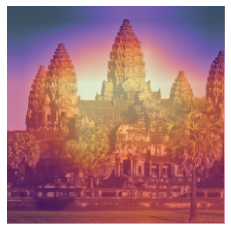

In [71]:
get_gradcam(learn, x, -1)

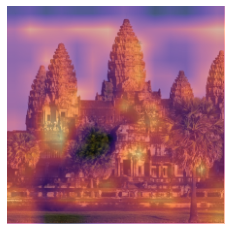

In [72]:
get_gradcam(learn, x, -2)

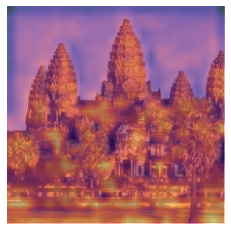

In [73]:
get_gradcam(learn, x, -3)

# Multioutput Model

In [21]:
def parent_label_multi(o):
    return [Path(o).parent.name]

multi_dblock = DataBlock(
    blocks=(ImageBlock, MultiCategoryBlock), # changed to MultiCategoryBlock
    get_items=get_image_files, 
    splitter=RandomSplitter(valid_pct=0.2, seed=42),
    get_y=parent_label_multi,
    item_tfms=Resize(460),
    batch_tfms=[*aug_transforms(size=224, min_scale=0.75),
                Normalize()]
)
multi_dls = multi_dblock.dataloaders(ds_train_path, bs=64)

In [9]:
dsets = multi_dblock.datasets(ds_path)
dsets.train[0][1]

TensorMultiCategory([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0.])

In [9]:
def accuracy_multi(inp, targ, thresh=0.5, sigmoid=True):
    "Compute accuracy when `inp` and `targ` are the same size."
    if sigmoid: inp = inp.sigmoid()
    return ((inp>thresh)==targ.bool()).float().mean()

In [ ]:
learn = vision_learner(multi_dls, resnet50, metrics=partial(accuracy_multi, thresh=0.2))
learn.fine_tune(10)

In [32]:
preds,targs = learn.get_preds()

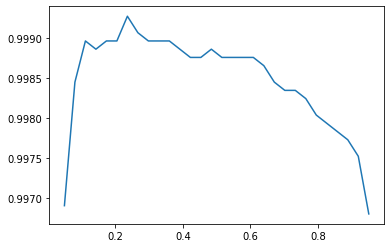

In [39]:
xs = torch.linspace(0.05,0.95,30)
accs = [accuracy_multi(preds, targs, thresh=i, sigmoid=False) for i in xs]
plt.plot(xs,accs);

In [17]:
learn = vision_learner(multi_dls, resnet50, metrics=partial(accuracy_multi, thresh=0.6))
learn.fine_tune(10)

epoch,train_loss,valid_loss,accuracy_multi,time
0,0.753648,0.409673,0.886319,01:18


/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))


epoch,train_loss,valid_loss,accuracy_multi,time
0,0.456244,0.269324,0.963139,01:34
1,0.347220,0.143646,0.992256,01:34
2,0.224832,0.054734,0.997109,01:34
3,0.133735,0.024566,0.997832,01:34
4,0.077024,0.012629,0.998451,01:33
5,0.044706,0.008756,0.998555,01:34
6,0.028495,0.006755,0.998658,01:32
7,0.019185,0.006248,0.998761,01:33
8,0.015679,0.005991,0.998658,01:33
9,0.013041,0.005977,0.998658,01:33


/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(st

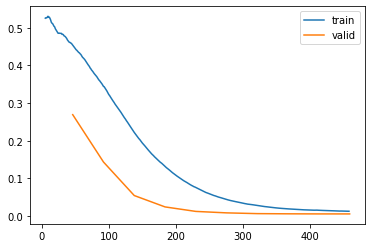

In [19]:
learn.recorder.plot_loss()

In [ ]:
learn = vision_learner(multi_dls, resnet50, metrics=partial(accuracy_multi, thresh=0.6))
learn.fine_tune(8)

/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth


  0%|          | 0.00/97.8M [00:00<?, ?B/s]

epoch,train_loss,valid_loss,accuracy_multi,time
0,0.752721,0.416331,0.882602,01:16


/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))


epoch,train_loss,valid_loss,accuracy_multi,time
0,0.456418,0.262549,0.964791,01:33
1,0.330013,0.111803,0.992359,01:37
2,0.203991,0.042892,0.997832,01:33
3,0.117192,0.020326,0.998038,01:34
4,0.069080,0.013076,0.998554,01:36
5,0.042571,0.009628,0.998451,01:34
6,0.030637,0.008396,0.998554,01:35


/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(str(msg))
/usr/local/lib/python3.9/dist-packages/PIL/TiffImagePlugin.py:845: UserWarning: Truncated File Read
  warnings.warn(st

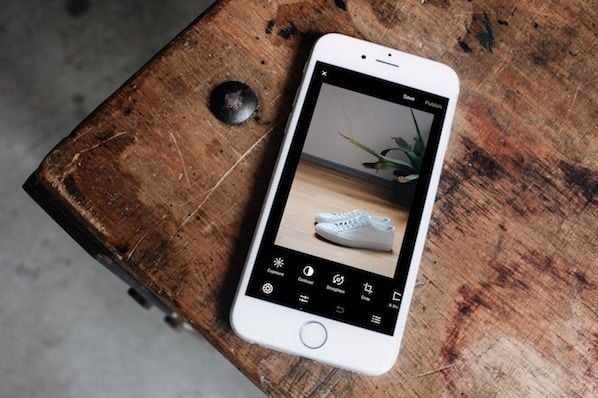

In [44]:
Image.open('unknown.jpg')

In [26]:
pred = learn.predict("unknown.jpg")
"Unknown" if len(pred[0]) == 0 else pred[0]

fastai.data.transforms.Category

In [43]:
learn.predict("taj_mahal.jpg")

((#1) ['Taj Mahal, Agra, India'],
 TensorBase([False, False, False, False, False, False, False, False,  True, False, False, False, False]),
 TensorBase([2.9029e-03, 1.2898e-03, 9.9002e-04, 2.6102e-03, 2.1720e-03, 1.8342e-03, 2.9727e-03, 1.1811e-03, 1.0000e+00, 1.9587e-03, 1.0812e-03, 2.4059e-03, 7.2303e-04]))

In [ ]:
learn.export(fname='model_multi.pkl')

In [31]:
path = Path()
path.ls(file_exts='.pkl')

(#2) [Path('model.pkl'),Path('model_multi.pkl')]

# Scaling up 

In [10]:
additional_classes = ['Stonehenge, United Kingdom', 'Leaning Tower of Pisa, Italy', 'Statue of Liberty, United States of America', 'Borobudur, Indonesia',
                     'Christ The Redeemer, Brazil', 'Chichen Itza, Mexico', 'Colosseum, Rome, Italy', 'Millau Viaduct, France', 'The Sydney Opera House, Australia',
                     'Saint Peters Basilica, Vatican City', 'Moai, Chile', 'Harmandir Sahib, Amritsar, India', 'Shwedagon Pagoda, Myanmar', 'Hagia Sophia, Turkey',
                     'Hallgrímskirkja, Reykjavík, Iceland', 'Vienna Opera House, Vienna, Austria', 'La Pedrera, Barcelona, Spain', 'Pena National Palace, Sintra, Portugal',
                     'The Duomo, Florence, Italy', 'Palace of Versailles, Paris, France', 'Marina Bay Sands, Singapore', 'Hawa Mahal, Jaipur, India',
                      'The Chrysler Building, New York, United States', 'Las Lajas Sanctuary, Nariño, Colombia', 'Dancing House, Prague, Czech Republic', 
                     'Semperoper, Dresden, Germany', 'Potala Palace, Lhasa, Tibet', 'Pyramids of Giza, Egypt', 'Itsukushima Shinto Shrine, Japan',
                      'Itsukushima Shinto Shrine, Japan', 'Rila Monastery, Bulgaria', 'Arg-e Bam, Iran', 'La Grand-Place, Brussels, Belgium', 'Meteora, Greece',
                     'Mir-i-Arab Madrasa, Bukhara, Uzbekistan', 'Notre Dame Cathedral, Paris, France', 'Prambanan, Indonesia', 'Neuschwanstein Castle, Schwangau, Germany',
                     'Machu Picchu, Peru', 'The Great Wall of China, China']

In [11]:
for c in additional_classes:
    dest_train = (ds_train_path/c)
    dest_test = (ds_test_path/c)
    dest_train.mkdir(exist_ok=True)
    dest_test.mkdir(exist_ok=True)
    urls = search_images_ddg(c, max_images=200)
    download_images(dest_train, urls=urls[:180])
    download_images(dest_test, urls=urls[180:])

In [ ]:
learn = vision_learner(multi_dls, resnet50, metrics=partial(accuracy_multi, thresh=0.7))
learn.fine_tune(8)

/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth


  0%|          | 0.00/97.8M [00:00<?, ?B/s]

epoch,train_loss,valid_loss,accuracy_multi,time
0,0.702062,0.197965,0.987544,02:48


epoch,train_loss,valid_loss,accuracy_multi,time
0,0.183107,0.077525,0.985616,03:25
1,0.081024,0.029952,0.989101,03:26
2,0.036921,0.013398,0.995209,03:23
